<a href="https://colab.research.google.com/github/Nasrin-Akhtar/Flight-Price-Prediction/blob/main/Flight_price_prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# *DATASET DESCRIPTION*

Dataset contains information about flight booking options from the website Easemytrip for flight travel between India's top 6 metro cities.
1. Airline: The name of the airline company is stored in the airline column. It is a categorical feature having 6 different airlines.
2. Flight: Flight stores information regarding the plane's flight code. It is a categorical feature.
3. Source City: City from which the flight takes off. It is a categorical feature having 6 unique cities.
4. Departure Time: This is a derived categorical feature obtained created by grouping time periods into bins. It stores information about the departure time and have 6 unique time labels.
5. Stops: A categorical feature with 3 distinct values that stores the number of stops between the source and destination cities.
6. Arrival Time: This is a derived categorical feature created by grouping time intervals into bins. It has six distinct time labels and keeps information about the arrival time.
7. Destination City: City where the flight will land. It is a categorical feature having 6 unique cities.
8. Class: A categorical feature that contains information on seat class; it has two distinct values: Business and Economy.
9. Duration: A continuous feature that displays the overall amount of time it takes to travel between cities in hours.
10. Days Left: This is a derived characteristic that is calculated by subtracting the trip date by the booking date.
11. Price: Target variable stores information of the ticket price.



## OBJECTIVE

The objective of the study is to analyse the flight booking dataset and to conduct various statistical hypothesis tests in order to get meaningful information from it. Then statistical algorithm would be used to train the dataset and predict a continuous target variable. A thorough study of the data will aid in the discovery of valuable insights that will be of enormous value to passengers.

# Importing libraries

In [33]:
import warnings
warnings.filterwarnings("ignore")

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns

import scipy.stats as stats
import statsmodels.api as sm
import pylab as py

#from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import mutual_info_regression
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline

from xgboost import XGBRegressor
from sklearn.linear_model import Lasso, Ridge,LinearRegression
from sklearn.linear_model import ElasticNet, BayesianRidge
from sklearn.ensemble import  RandomForestRegressor

from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.model_selection import cross_validate
from sklearn import metrics
from sklearn.preprocessing import StandardScaler




# Load dataset

In [2]:
df=pd.read_csv('/content/Flights_prices.csv')
df.head()

,Unnamed: 0,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,Class,duration,days_left,price
0,0,SpiceJet,SG-8709,Delhi,Evening,zero,Night,Mumbai,Economy,2.17,1,5953
1,1,SpiceJet,SG-8157,Delhi,Early_Morning,zero,Morning,Mumbai,Economy,2.33,1,5953
2,2,AirAsia,I5-764,Delhi,Early_Morning,zero,Early_Morning,Mumbai,Economy,2.17,1,5956
3,3,Vistara,UK-995,Delhi,Morning,zero,Afternoon,Mumbai,Economy,2.25,1,5955
4,4,Vistara,UK-963,Delhi,Morning,zero,Morning,Mumbai,Economy,2.33,1,5955


In [3]:
#checking of missing values
df.isnull().sum()

Unnamed: 0          0
airline             0
flight              0
source_city         0
departure_time      0
stops               0
arrival_time        0
destination_city    0
Class               0
duration            0
days_left           0
price               0
dtype: int64

In [4]:
df=df.drop('Unnamed: 0',axis=1)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 300153 entries, 0 to 300152
Data columns (total 11 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   airline           300153 non-null  object 
 1   flight            300153 non-null  object 
 2   source_city       300153 non-null  object 
 3   departure_time    300153 non-null  object 
 4   stops             300153 non-null  object 
 5   arrival_time      300153 non-null  object 
 6   destination_city  300153 non-null  object 
 7   Class             300153 non-null  object 
 8   duration          300153 non-null  float64
 9   days_left         300153 non-null  int64  
 10  price             300153 non-null  int64  
dtypes: float64(1), int64(2), object(8)
memory usage: 25.2+ MB


In [6]:
df[df.duplicated()]

,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,Class,duration,days_left,price


In [7]:
df.shape

(300153, 11)

**Therefore our dataset contain six categorical feature and 4 numeric feature**

In [8]:
#Adding the column comibine of source city & destination city for better visualisation
df['Travelling_cities']=df['source_city']+'-'+df['destination_city']

In [ ]:
#converting duration to minuties for better calculation
df['duration']=df['duration'].astype(str)
df['duration_h']=df['duration'].str.split('.').str[0]
df['duration_m']=df['duration'].str.split('.').str[1]
df['duration_h']=df['duration_h'].astype(int)
df['duration_m']=df['duration_m'].astype(int)
df['duration_mins'] = (df['duration_h']*60)+df['duration_m']
df.drop(['duration_h','duration_m'],axis=1,inplace=True)
df['duration']=df['duration'].astype(float)


In [9]:
df.tail()

,airline,flight,source_city,departure_time,stops,arrival_time,destination_city,Class,duration,days_left,price,Travelling_cities
300148,Vistara,UK-822,Chennai,Morning,one,Evening,Hyderabad,Business,10.08,49,69265,Chennai-Hyderabad
300149,Vistara,UK-826,Chennai,Afternoon,one,Night,Hyderabad,Business,10.42,49,77105,Chennai-Hyderabad
300150,Vistara,UK-832,Chennai,Early_Morning,one,Night,Hyderabad,Business,13.83,49,79099,Chennai-Hyderabad
300151,Vistara,UK-828,Chennai,Early_Morning,one,Evening,Hyderabad,Business,10.00,49,81585,Chennai-Hyderabad
300152,Vistara,UK-822,Chennai,Morning,one,Evening,Hyderabad,Business,10.08,49,81585,Chennai-Hyderabad


# Summary Statistics


In [10]:
def summary(df):
    df.shape
    print(f"Dataset has {df.shape[1]} features and {df.shape[0]} observations.")
    summary = pd.DataFrame(index=df.columns)
    summary["Unique"] = df.nunique().values
    summary["Missing"] = df.isnull().sum().values
    summary["Types"] = df.dtypes
    return summary
summary(df)

Dataset has 12 features and 300153 observations.


,Unique,Missing,Types
airline,6,0,object
flight,1561,0,object
source_city,6,0,object
departure_time,6,0,object
stops,3,0,object
arrival_time,6,0,object
destination_city,6,0,object
Class,2,0,object
duration,476,0,float64
days_left,49,0,int64


In [12]:
df[['duration','days_left','price']].describe().transpose()


,count,mean,std,min,25%,50%,75%,max
duration,300153.0,12.221021,7.191997,0.83,6.83,11.25,16.17,49.83
days_left,300153.0,26.004751,13.561004,1.00,15.00,26.00,38.00,49.00
price,300153.0,20889.660523,22697.767366,1105.00,4783.00,7425.00,42521.00,123071.00


*we can see mean and median values are quite different from each other and mean is greater than median, which is a sign of the distribution to be Positively Skewed for price*

#Feature Distribution and Univariate plotting

In [13]:
def distribution(data,feature):
    sns.displot(data[feature],kind='kde')
    print(data[feature].agg(['skew','kurtosis']))

skew        1.061377
kurtosis   -0.396293
Name: price, dtype: float64


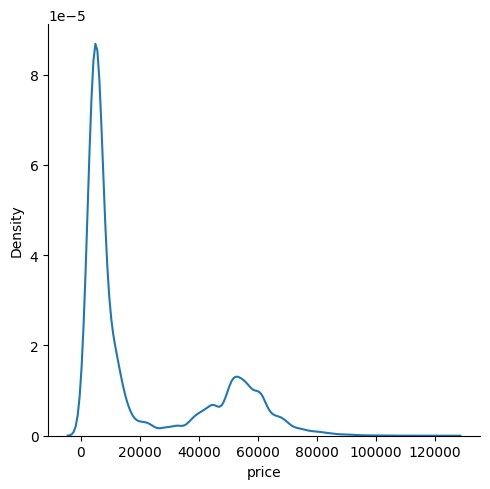

In [14]:
distribution(df,'price')

Two pick has been found in the dataset. The reason can be Economy and Business class. As prices varries depending on class

skew       -0.035464
kurtosis   -1.156215
Name: days_left, dtype: float64


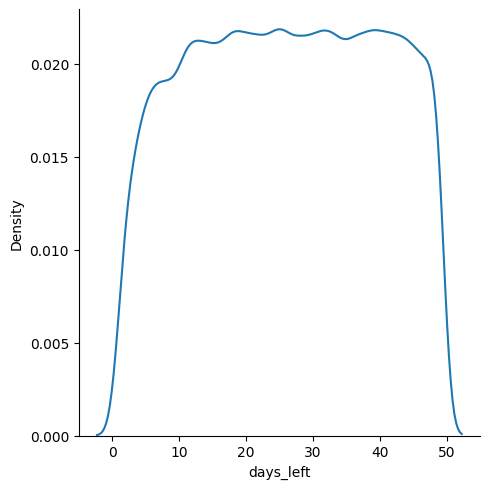

In [15]:
distribution(df,'days_left')

it is negatively skewed and platykurtic

skew        0.602899
kurtosis   -0.268996
Name: duration, dtype: float64


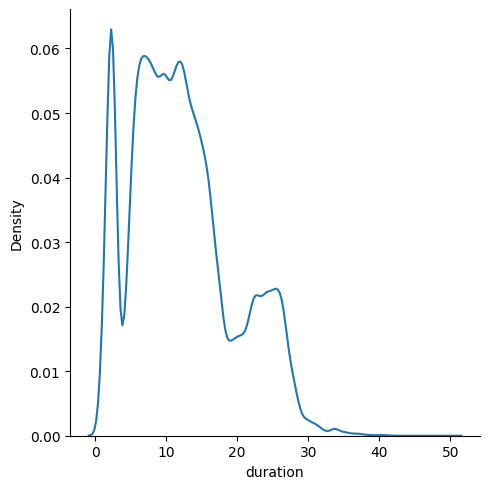

In [17]:
distribution(df,'duration')

*Hence  duration is also positively skewed and as kurtosis values are negative we an say they are platykurtic.*

*So far, the computation we made are all based on numeric values. We have no idea about the categorical feature here. Let's look on the categorical features based on unique value counts*

# Frequency tables and univariate plotting

The summary techniques we have used so far are suitable only for numeric variables. Categorical variables have values which are typically unordered. Therefore, we need a method to summarize categorical variables based on counts. Frequency tabulation is one way of getting a better idea of the distribution of categorical variables.

In [ ]:
selected_columns=['airline','source_city','departure_time','stops','arrival_time','destination_city','Class','Travelling_cities']

def univariate_plotting(df):
    for item in selected_columns:
        unique_value=df[item].nunique()
        if df[item].dtypes!='int64' and unique_value<6:
            dummy_df=df[item].value_counts()
            fig=px.pie(dummy_df,names=dummy_df.index,values=dummy_df.values,title=f'Percentage of employees {item}')
            fig.update_layout(height=600,width=500)
            fig.show()
        elif unique_value < 10:
            fig=px.histogram(df,x=item,title=f'Graphical representation of {item}',color=item,nbins=30, text_auto=False,pattern_shape='Class')
            fig.update_layout(xaxis_title=item, yaxis_title='Frequency',height=600,width=800)
            fig.show()
        elif unique_value < 60:
            fig=px.histogram(df,x=item,title=f'Graphical representation of {item}',nbins=30, text_auto=False)
            fig.update_layout(xaxis_title=item, yaxis_title='Frequency',height=600,width=800)
            fig.show()
        else:
            dummy_df=df[item].value_counts()[:50]
            fig=px.treemap(dummy_df,path = [dummy_df.index],values=dummy_df.values,title=f'Treemap representation of top 50 {item}')
            fig.update_layout(height=600,width=800)
            fig.show()
univariate_plotting(df)

Therefore,
 1. Only Vistara and Air India has Business class and most of the flights are of 'Vistara' airline.
 2. Most of the flights are depart in the morning and very few around Late night.
 3. Similar ways arrival flights are mostly found in evening-night timing whereas least in the early-morning or late night. Passengers prefer flighing in the day- evening times. Early- morning and late night flights are mostly avoided by passengers.
 4. 83% of the flights have one layover in between journey.
 5. 68.9% of the passengers are using Economy class.
 6. Maximum number of flights are found in between 'Delhi' and  'Mumbai' and the number is 15.289k
 7. Least number of flights are found in between 'Chennai- Hyderabad' and the number is 6103.


In [18]:
df.departure_time.value_counts()

Morning          71146
Early_Morning    66790
Evening          65102
Night            48015
Afternoon        47794
Late_Night        1306
Name: departure_time, dtype: int64

In [19]:
df.arrival_time.value_counts()

Night            91538
Evening          78323
Morning          62735
Afternoon        38139
Early_Morning    15417
Late_Night       14001
Name: arrival_time, dtype: int64

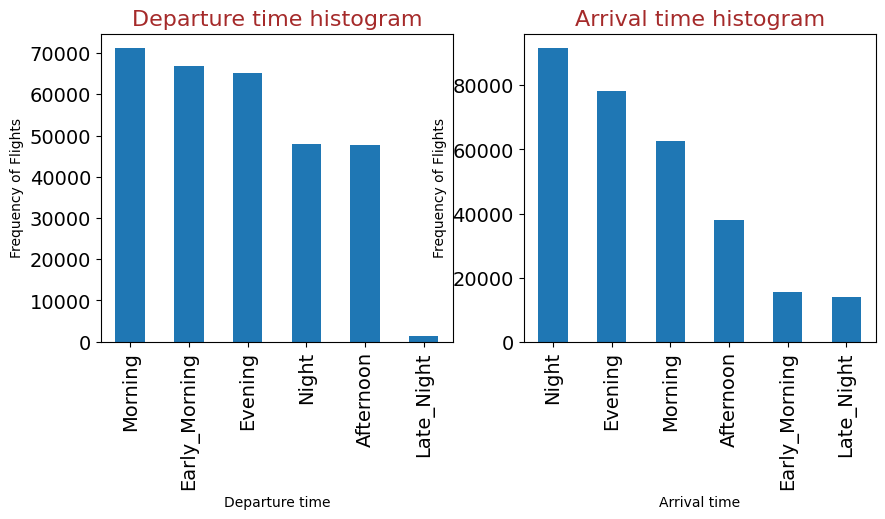

In [20]:
plt.figure(figsize=(10,4))
plt.subplot(1,2,1)
plt.title('Departure time histogram',fontsize=16).set_color("brown")
plt1 = df.departure_time.value_counts().plot(kind='bar',fontsize=14)
plt1.set(xlabel = 'Departure time', ylabel='Frequency of Flights')



plt.subplot(1,2,2)
plt.title('Arrival time histogram',fontsize=16).set_color('brown')
plt1 = df.arrival_time.value_counts().plot(kind='bar',fontsize=14)
plt1.set(xlabel = 'Arrival time',ylabel='Frequency of Flights')
plt.show()

In [21]:
df.Class.value_counts()

Economy     206666
Business     93487
Name: Class, dtype: int64

In [22]:
df.airline.value_counts()

Vistara      127859
Air_India     80892
Indigo        43120
GO_FIRST      23173
AirAsia       16098
SpiceJet       9011
Name: airline, dtype: int64

Text(0.5, 1.0, 'AIRLINES')

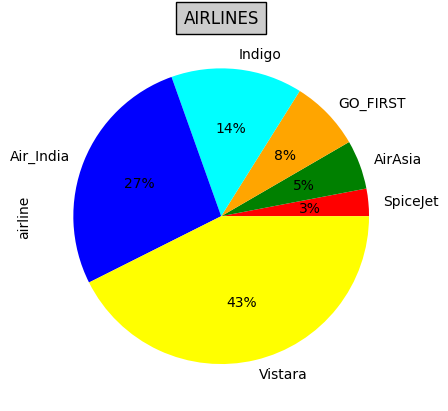

In [23]:
df.groupby('airline')['airline'].count().sort_values().plot(kind='pie',autopct='%1.0f%%',colors=['red','green','orange','cyan','blue','yellow'])
plt.title("AIRLINES",bbox={'facecolor':'0.8','pad':5})


1. Here we can see 'VISTARA' airline flies in maximum number. VISTARA is a joint venture between Tata Sons and Singapore   Airlines.The name VISTARA is symbolic of its vision of infinite expansion and the desire of the airline to become the Best Airline in INDIA to the people. Headquaters-GURGAON

2. 'Spicejet' flies the least number.

3. Here as we can see maximum flights are from Air_India and Vistara compare to other Airlines that is 27% and 43% respectively maybe one of the reasons behind this is, No other Airlines have business class except  this  two.

In [24]:
df.groupby(['airline'])['price'].mean()

airline
AirAsia       4091.072742
Air_India    23507.019112
GO_FIRST      5652.007595
Indigo        5324.216303
SpiceJet      6179.278881
Vistara      30396.536302
Name: price, dtype: float64

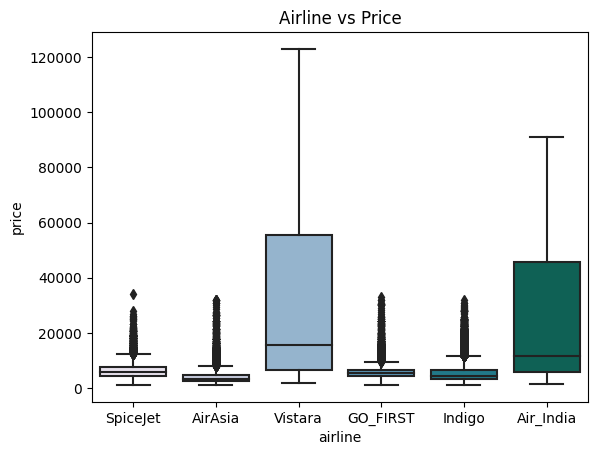

In [ ]:

plt.title('Airline vs Price')
sns.boxplot(x=df.airline, y=df.price, palette=("PuBuGn"))
plt.show()

Hence, Spicejet is comparatively expensive for economic class tickets. Whereas Vistara come first when business class is included.

In [25]:
economy=df[df.Class=='Economy']
business=df[df.Class=='Business']

In [27]:
def bivariate_plotting(df):
    selected_columns=['stops', 'departure_time', 'arrival_time','days_left']
    for item in selected_columns:
        unique_values=df[item].nunique()
        if unique_values>15:
            dummy_df=df.groupby([item])['price'].mean()
            fig=px.bar(dummy_df,x=dummy_df.index,y=dummy_df.values,title=f'Prices with respect to {item} for Economy class')
            #fig.add_trace(go.Scatter(x = dummy_df.index, y = dummy_df.values, mode="markers+lines",name = 'Trend Line',line=dict( color='blue')))
            fig.update_layout(xaxis_title=item, yaxis_title='price',height=600,width=800)
            fig.show()
        elif unique_values<70:
            dummy_df=df.groupby([item])['price'].mean()
            fig=px.bar(dummy_df,x=dummy_df.index,y=dummy_df.values,color=dummy_df.index,title=f'Prices with respect to {item} for Economy class')
            #fig.add_trace(go.Scatter(x = dummy_df.index, y = dummy_df.values, mode="markers+lines",name = 'Trend Line',line=dict( color='blue')))
            fig.update_layout(xaxis_title=item, yaxis_title='price',height=600,width=800)
            fig.show()
        else:
            dummy_df=df.sort_values(by='price').groupby([item])['price'].mean()[-15:]
            fig=px.bar(dummy_df,x=dummy_df.index,y=dummy_df.values,color=dummy_df.index,title=f'Salaries with respect to {item} for Economy class')
            #fig.add_trace(go.Scatter(x = dummy_df.index, y = dummy_df.values, mode="markers+lines",name = 'Trend Line',line=dict( color='blue')))
            fig.update_layout(xaxis_title=item, yaxis_title='price',height=600,width=800)
            fig.show()

bivariate_plotting(economy)


In [28]:

bivariate_plotting(business)


In [30]:
dummy_df=df.groupby(['Class'])['price'].mean()
fig=px.bar(dummy_df,x=dummy_df.index,y=dummy_df.values,title=f'Prices with respect to Class',color=dummy_df.index)
fig.update_layout(xaxis_title='Class', yaxis_title='price',height=600,width=800)
fig.show()

### Covariance and correlation
Covariance is  basically a measure of how much two random variables change together.
The correlation coefficient is the specific measure that quantifies the strength of the linear relationship between two variable in a correlation analysis

In [31]:
print(df.corr())

           duration  days_left     price
duration   1.000000  -0.039157  0.204222
days_left -0.039157   1.000000 -0.091949
price      0.204222  -0.091949  1.000000


<ipython-input-31-23236a4e6045>:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



<Axes: >

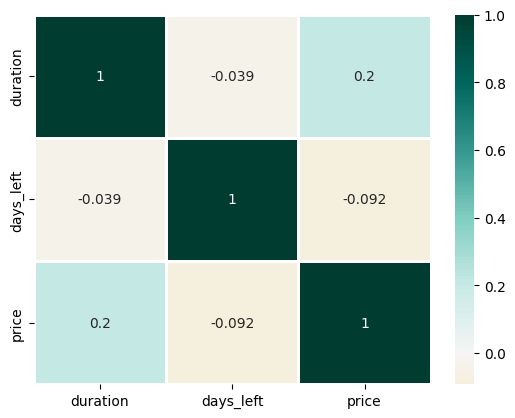

In [34]:
sns.heatmap(df.corr(),center=0,annot=True,linewidths=.8,cmap='BrBG')

The correlation matrix is a bit easier to understand, since the values are normalized. The diagonal values of the correlation matrix are all 1, as a result of the normalization. The magnitudes of the correlation values between the variables range between -1 and +1. A magnitude closer to +1 or -1 indicates a high correlation.

Some pairs of variables are weakly correlated, with small magnitudes. For example, **Price** and **Days_left** are weakly correlated.

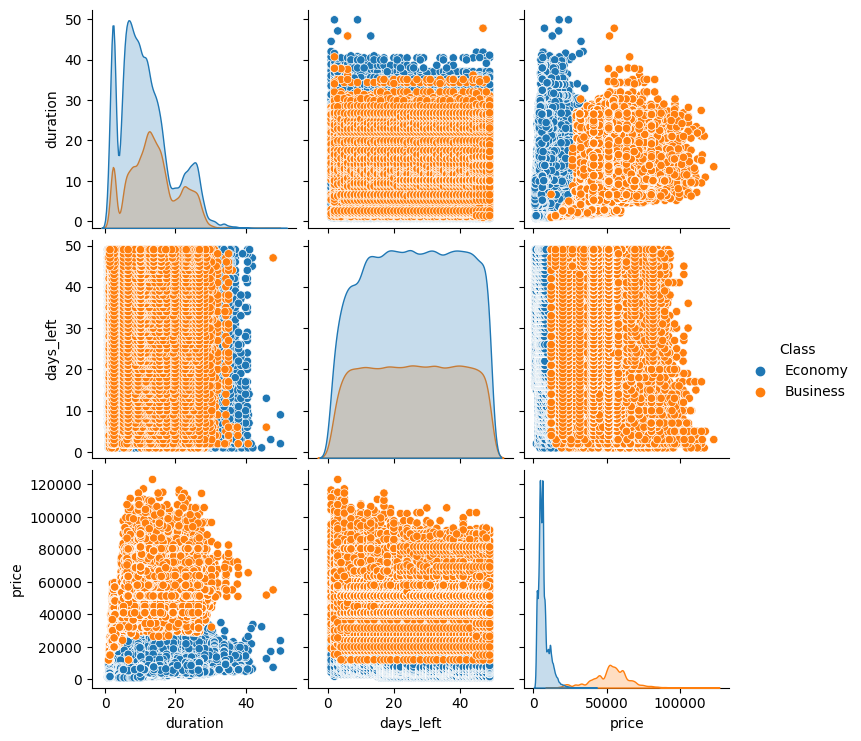

In [36]:
sns.pairplot(df,hue='Class',aspect=True)

The pairplot() function of seaborn helps in creating an axes grid through which each numeric variable present in data is shared across y-axes in the form of rows and across x-axes in form of a column. Scatter plots are created to show pairwise relationships and in the diagonal, the distribution plot is created to show the distribution of the data in the column.

# INFERENTIAL STATISTICS

# *test of homogeneity of Proportion*

Null Hypothesis (H0): The proportions of the classes are homogeneous or the same across all groups or categories. In other words, there is no significant difference in the proportions

Alternative Hypothesis (Ha): The proportions of the classes are not homogeneous across all groups or categories. In other words, there is a significant difference in at least one proportion

In [37]:
df_table= pd.crosstab(df.airline,df.Class)
print(df_table)

Class      Business  Economy
airline                     
AirAsia           0    16098
Air_India     32898    47994
GO_FIRST          0    23173
Indigo            0    43120
SpiceJet          0     9011
Vistara       60589    67270


In [38]:
df_table2= df_table.drop(['AirAsia','GO_FIRST','Indigo','SpiceJet'])
df_table2

Class,Business,Economy
airline,,
Air_India,32898,47994
Vistara,60589,67270


Here as we see value counts of AirAsia, GO_FIRST,Indigo,Spicejet are 0 or null for business class therefore this values are not necessary for our testing so we removing this given rows.Hence we get our 2*2 contingency table

In [39]:
chi_t=stats.chi2_contingency(df_table2)
chi_t

Chi2ContingencyResult(statistic=904.0884643034778, pvalue=1.2677684853623123e-198, dof=1, expected_freq=array([[36226.65474177, 44665.34525823],
       [57260.34525823, 70598.65474177]]))

# *categorsing dataframe according number of stops between Travelling cities and proceeding to determine further results*

In [40]:
Stops2=df[df.stops=='two_or_more']
Stops1=df[df.stops=='one']
Stops0=df[df.stops=='zero']


In [41]:
df.price.groupby(df.stops).agg(['count','median','mean','std','max','min'])

,count,median,mean,std,max,min
stops,,,,,,
one,250863,7959.0,22900.992482,23626.066584,123071,1105
two_or_more,13286,8307.0,14113.450775,17664.332033,117307,1966
zero,36004,4499.0,9375.938535,10623.008293,59573,1105


<Axes: xlabel='stops', ylabel='price'>

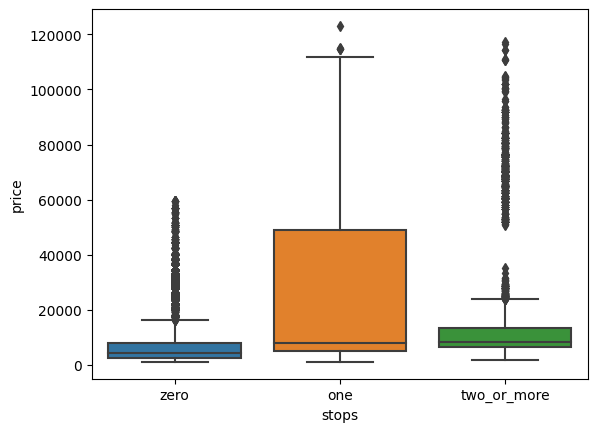

In [43]:
sns.boxplot(x=df['stops'],y=df['price'])

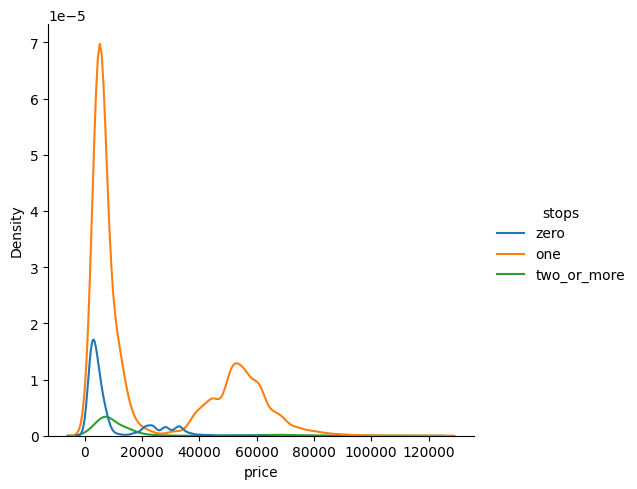

In [42]:
sns.displot(df,x='price',hue='stops',kind='kde')

**H0: price mean are equal for all stops airlines/ prices do not depend on number of stops between travelling cities**

**H1: there is atleast one type for which mean price is different/prices varries according number of stops between travelling cities**   

In [44]:
t_stat,pvalue=stats.kruskal(Stops0['price'],Stops1['price'],Stops2['price'])
print(pvalue)
if pvalue<=0.05:
    print('we reject null hypothesis')
else:
    print('we fail to reject null hypothesis')

0.0
we reject null hypothesis


#we reject null hypothesis therefore there is significance difference in between

In [ ]:
#here we apply kruskal-wallis test to determine effect of stops in the journey which is equivalent to one way anova test in case of parametric test
#Also as we are using kruskal-wallis non parametric test we don't really need to remove the outlier for prices with 2 stps flights .Therefore using whole prices without removing any outliers

# test between price & class price - airlines, price-days_left

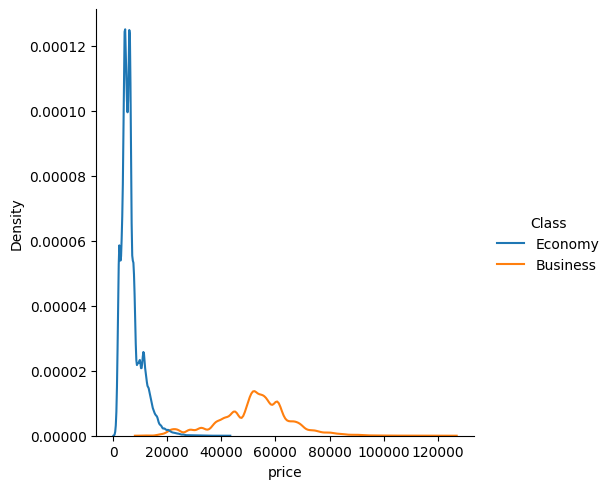

In [45]:
sns.displot(df,x='price',hue='Class',kind='kde')

<Axes: xlabel='price', ylabel='Class'>

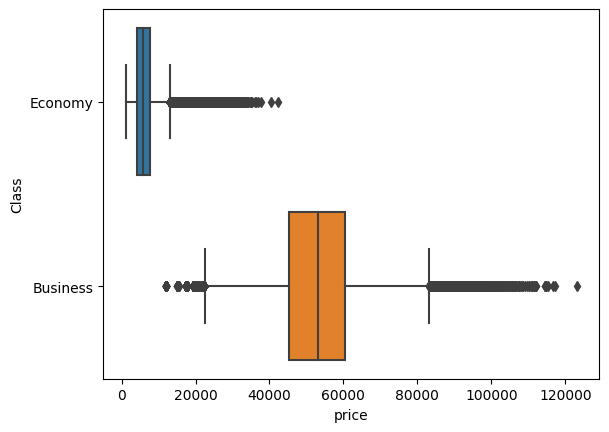

In [46]:
sns.boxplot(x=df['price'],y=df['Class'])

In [47]:
df['price_']=np.log(df['price'])

0.8976759910583496 0.0


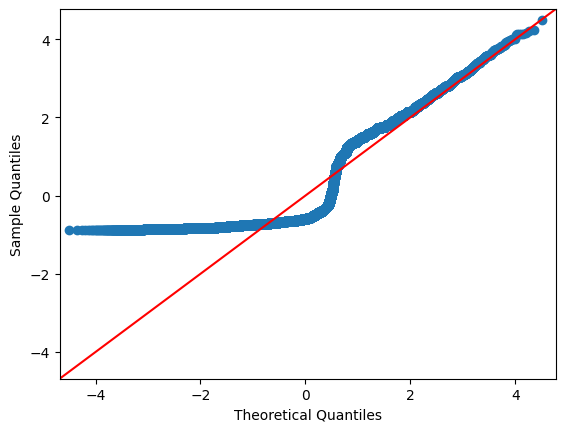

In [48]:
test_stat,p_value= stats.shapiro(df['price_'])
print(test_stat,p_value)
sm.qqplot(df['price'],line='45', fit=True,dist=stats.norm)
py.show()

# Feature Engineering

In [49]:

df["Class"] = df["Class"].replace({'Economy':0,'Business':1}).astype(int)
df["stops"] = df["stops"].replace({'zero':0,'one':1,'two_or_more':2}).astype(int) #Encode the ordinal variable
    #Create the dummy variables for the cities, the times and the airlines.
dummies_variables = ["airline","source_city","destination_city","departure_time","arrival_time"]
dummy = pd.get_dummies(df[dummies_variables], drop_first= True,dtype=int)

con_col=df[['price','days_left','Class','stops']]
dummy_df=pd.concat([con_col,dummy],axis=1)
dummy_df.head()



,price,days_left,Class,stops,airline_Air_India,airline_GO_FIRST,airline_Indigo,airline_SpiceJet,airline_Vistara,source_city_Chennai,...,departure_time_Early_Morning,departure_time_Evening,departure_time_Late_Night,departure_time_Morning,departure_time_Night,arrival_time_Early_Morning,arrival_time_Evening,arrival_time_Late_Night,arrival_time_Morning,arrival_time_Night
0,5953,1,0,0,0,0,0,1,0,0,...,0,1,0,0,0,0,0,0,0,1
1,5953,1,0,0,0,0,0,1,0,0,...,1,0,0,0,0,0,0,0,1,0
2,5956,1,0,0,0,0,0,0,0,0,...,1,0,0,0,0,1,0,0,0,0
3,5955,1,0,0,0,0,0,0,1,0,...,0,0,0,1,0,0,0,0,0,0
4,5955,1,0,0,0,0,0,0,1,0,...,0,0,0,1,0,0,0,0,1,0


In [50]:
def make_mi_scores(X,Y):
    X = X.copy()
    for colname in X.select_dtypes(["object", "category"]):
        X[colname]= X[colname].factorize()
    # All discrete features should now have integer dtypes
    discrete_features = [pd.api.types.is_integer_dtype(t) for t in X.dtypes]
    mi_scores = mutual_info_regression(X,Y, discrete_features=discrete_features, random_state=0)
    mi_scores = pd.Series(mi_scores,name="MI Scores",index=X.columns)
    mi_scores = mi_scores.sort_values(ascending=False)
    return mi_scores

In [51]:
X=dummy_df.copy()
y=X.pop('price')
mi_scores = make_mi_scores(X, y)

In [52]:

mm=mi_scores.sort_values(ascending=True)
print(mi_scores.sort_values(ascending=True))

selected_columns = mi_scores[mi_scores > 0].index

X_new=dummy_df[selected_columns]
X_new.head()
X_new.shape#mutual info regressor score to check dependency

departure_time_Late_Night       0.013016
arrival_time_Late_Night         0.071299
arrival_time_Early_Morning      0.080712
departure_time_Night            0.081756
airline_SpiceJet                0.085591
departure_time_Early_Morning    0.087851
departure_time_Morning          0.092514
arrival_time_Morning            0.099318
departure_time_Evening          0.105128
arrival_time_Night              0.106584
arrival_time_Evening            0.127786
airline_GO_FIRST                0.202394
airline_Indigo                  0.288397
destination_city_Chennai        0.303454
destination_city_Hyderabad      0.320953
source_city_Chennai             0.326143
destination_city_Kolkata        0.338765
source_city_Hyderabad           0.347319
source_city_Kolkata             0.361463
destination_city_Mumbai         0.382741
destination_city_Delhi          0.388285
stops                           0.392300
airline_Air_India               0.403955
source_city_Mumbai              0.429708
source_city_Delh

(300153, 28)

In [53]:
scaler=StandardScaler()
x_scaled = scaler.fit_transform(X_new)

In [54]:
X_train, X_test, y_train, y_test = train_test_split(X_new,y, test_size=0.2,random_state=42)

In [55]:
models=[('LR',LinearRegression()),
       ('Lasso', Lasso()),
        ('Ridge', Ridge()),
        ('Bayesian Ridge', BayesianRidge()),
        ('Random Forest', RandomForestRegressor())]

In [56]:
for name,model in models:
    pipeline = Pipeline([('model',model)])
    pipeline.fit(X_train, y_train)
    y_pred = pipeline.predict(X_test)
    mse = mean_squared_error(y_test,y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y_test,y_pred)
    R2_score=r2_score(y_test,y_pred)
    print( name, ":",rmse, R2_score)

LR : 6828.818014782985 0.9095356758707356
Lasso : 6829.016752521177 0.9095304102634986
Ridge : 6828.817167943912 0.9095356983076257
Bayesian Ridge : 6828.8174943986405 0.9095356896582509
Random Forest : 4441.4978382093705 0.9617311708698693
